<a href="https://colab.research.google.com/github/Anantbir-S/AER850_Project3/blob/main/Final2_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Saving motherboard_image.JPEG to motherboard_image (1).JPEG


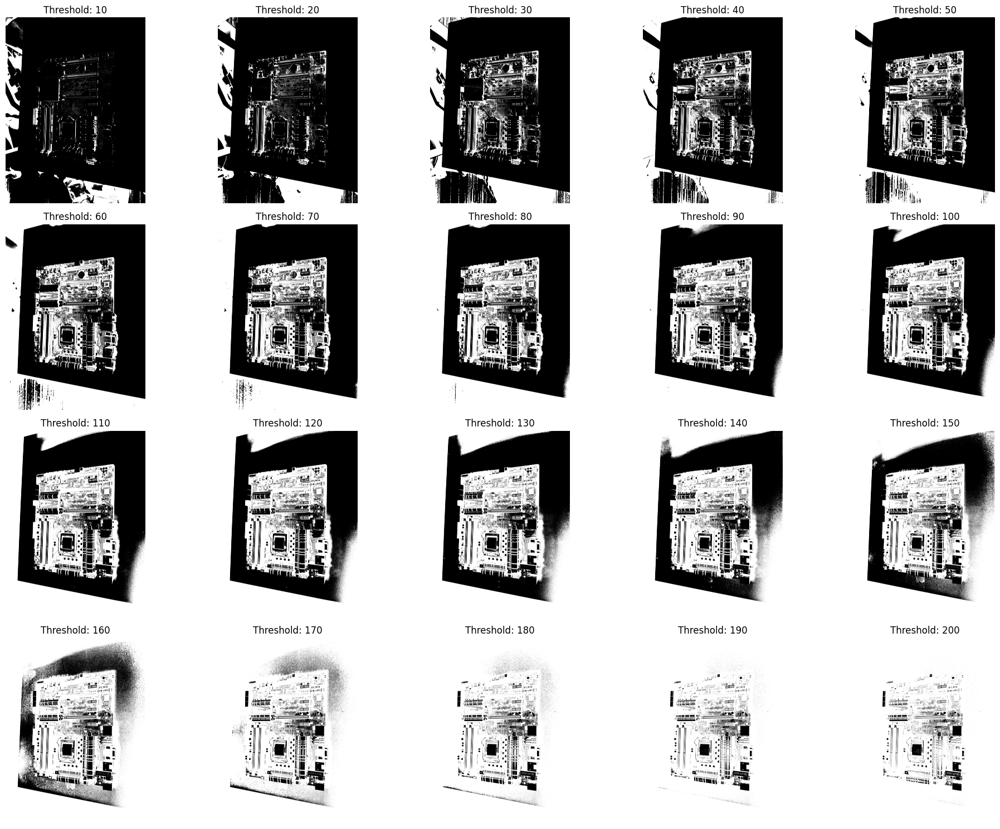

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files

# Upload your image (e.g., motherboard_image.JPEG) from the local machine
uploaded = files.upload()
filename = list(uploaded.keys())[0]

# Load the image
img = cv2.imread(filename)

# Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Define a range of threshold values (e.g., from 10 to 200)
threshold_values = np.linspace(10, 200, 20, dtype=int)

# Create a figure to display the results
plt.figure(figsize=(20, 15))

# Loop through each threshold value, apply thresholding, and display the result
for i, thresh_val in enumerate(threshold_values):
    # Apply binary thresholding
    _, thresh = cv2.threshold(gray, thresh_val, 255, cv2.THRESH_BINARY_INV)

    # Plot the result
    plt.subplot(4, 5, i + 1)  # 4 rows, 5 columns for 20 thresholds
    plt.imshow(thresh, cmap='gray')
    plt.title(f"Threshold: {thresh_val}")
    plt.axis('off')

# Display all results
plt.tight_layout()
plt.show()

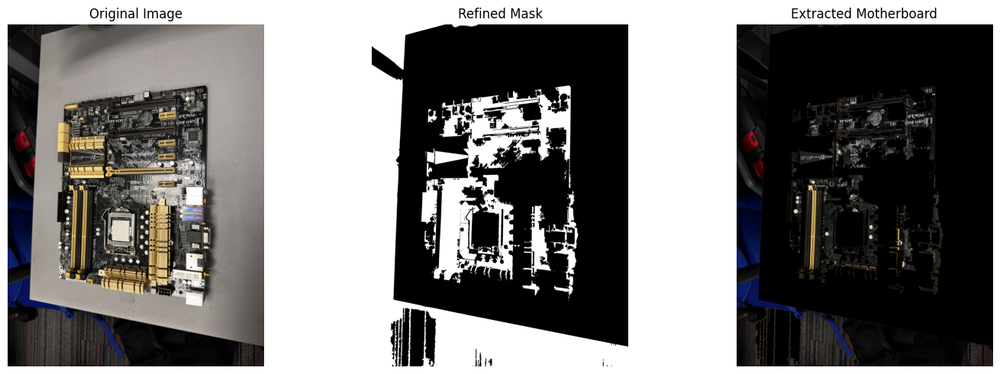

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the uploaded image
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

# Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Apply thresholding at 50
_, thresh = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY_INV)

# Find contours
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Create a mask
mask = np.zeros_like(gray)

# Filter contours by area (keep only the largest one assuming it's the motherboard)
for contour in contours:
    if cv2.contourArea(contour) > 10000:  # Adjust area threshold as needed
        cv2.drawContours(mask, [contour], -1, 255, thickness=cv2.FILLED)

# Refine the mask with morphological operations
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

# Extract the motherboard using the mask
extracted = cv2.bitwise_and(img, img, mask=mask)

# Display the results
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title("Refined Mask")
plt.imshow(mask, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title("Extracted Motherboard")
plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()


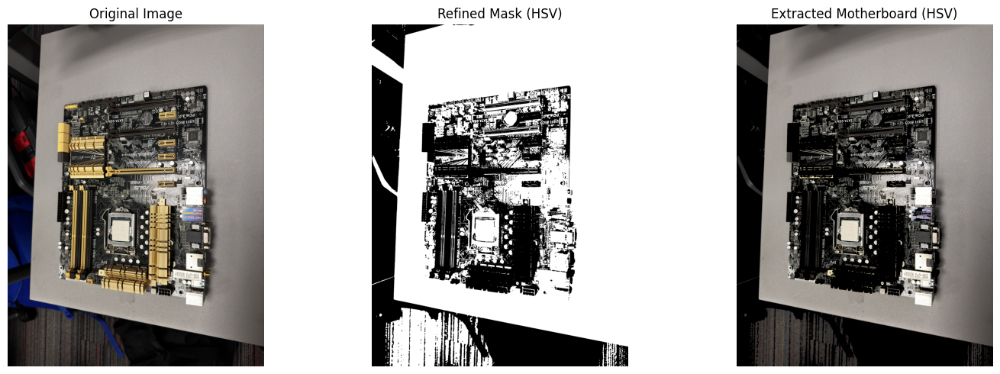

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

# Convert to HSV color space
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# Define the range for the motherboard colors (adjust these values as needed)
# These ranges should target the dominant colors of the motherboard
lower_bound = np.array([0, 0, 40])  # Adjust based on your motherboard's color
upper_bound = np.array([180, 80, 255])

# Create a mask for the specified color range
mask = cv2.inRange(hsv, lower_bound, upper_bound)

# Apply morphological operations to refine the mask
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

# Use the mask to extract the motherboard from the image
extracted = cv2.bitwise_and(img, img, mask=mask)

# Display the results
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title("Refined Mask (HSV)")
plt.imshow(mask, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title("Extracted Motherboard (HSV)")
plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()


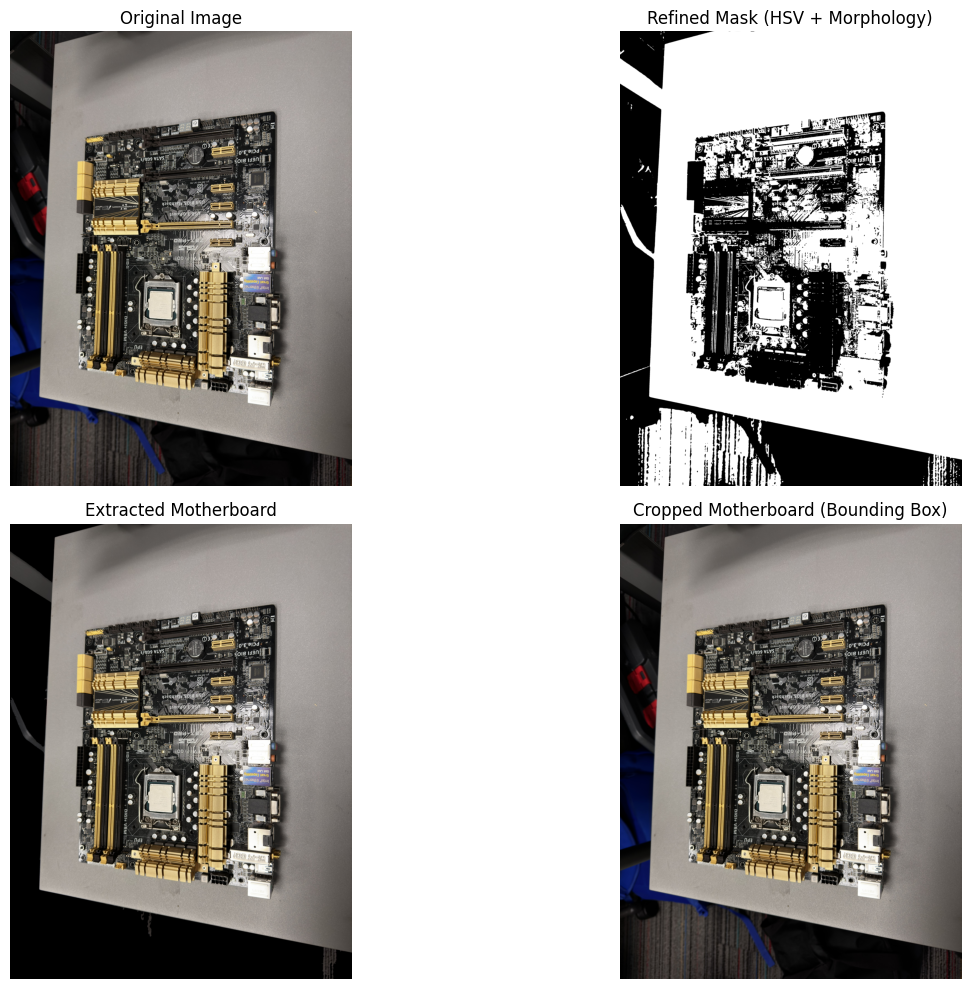

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

# Convert to HSV color space
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# Define the range for the motherboard colors (adjust these values as needed)
lower_bound = np.array([0, 0, 40])  # Adjust based on your motherboard's color
upper_bound = np.array([180, 80, 255])

# Create a mask for the specified color range
mask = cv2.inRange(hsv, lower_bound, upper_bound)

# Apply morphological operations to refine the mask
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

# Find contours from the mask
contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Create a blank mask for the largest contour
largest_contour = max(contours, key=cv2.contourArea) if contours else None
contour_mask = np.zeros_like(mask)

if largest_contour is not None:
    # Draw the largest contour
    cv2.drawContours(contour_mask, [largest_contour], -1, 255, thickness=cv2.FILLED)

    # Find bounding box of the largest contour
    x, y, w, h = cv2.boundingRect(largest_contour)
    cropped = img[y:y+h, x:x+w]  # Crop the bounding box region

    # Extract motherboard using the contour mask
    extracted = cv2.bitwise_and(img, img, mask=contour_mask)
else:
    print("No contours detected.")
    extracted = img
    cropped = img

# Display the results
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 2, 2)
plt.title("Refined Mask (HSV + Morphology)")
plt.imshow(mask, cmap='gray')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.title("Extracted Motherboard")
plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 2, 4)
plt.title("Cropped Motherboard (Bounding Box)")
plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()


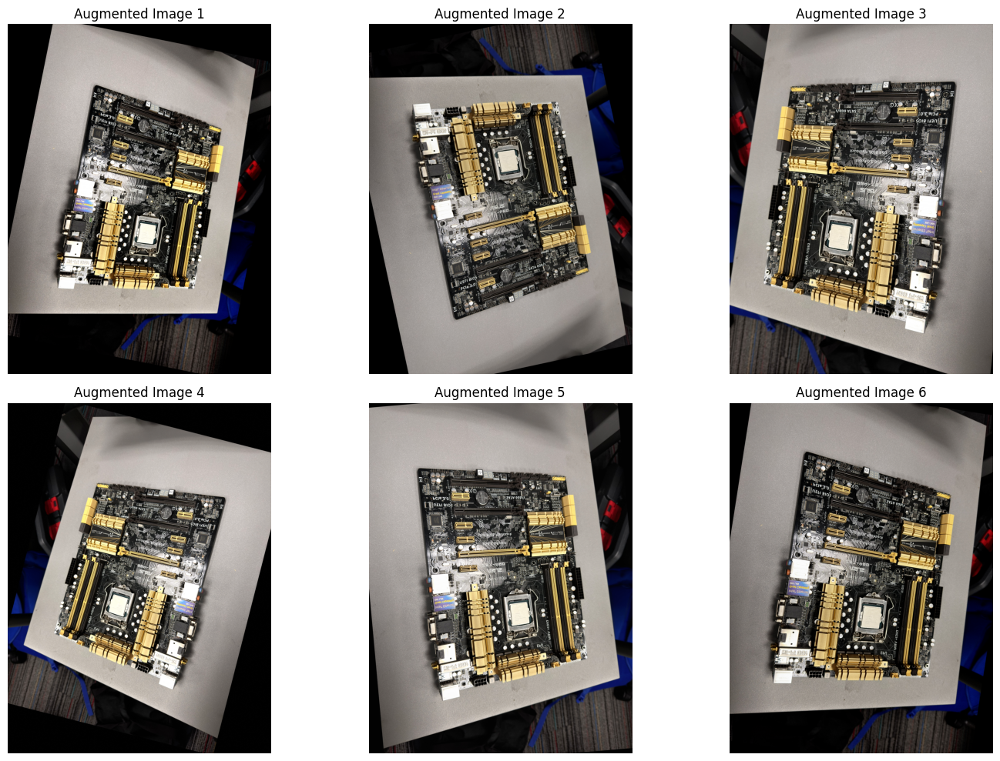

In [ ]:
import cv2
import numpy as np
import imgaug.augmenters as iaa
import matplotlib.pyplot as plt
import os

# Load the image
image_path = '//content/motherboard_image (1).JPEG'
img = cv2.imread(image_path)

# Check if the image was loaded successfully
if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Define augmentation sequence
seq = iaa.Sequential([
    iaa.Fliplr(0.5),  # 50% chance to flip horizontally
    iaa.Flipud(0.2),  # 20% chance to flip vertically
    iaa.Affine(
        rotate=(-15, 15),  # Rotate between -15 to 15 degrees
        shear=(-10, 10),   # Shear between -10 to 10 degrees
        scale=(0.8, 1.2)   # Scale between 80% to 120%
    ),
    iaa.AdditiveGaussianNoise(scale=(0, 0.05*255)),  # Add Gaussian noise
    iaa.Multiply((0.8, 1.2)),  # Random brightness
    iaa.LinearContrast((0.8, 1.2))  # Random contrast
])

# Create a directory to save augmented images
output_dir = '/mnt/data/augmented_images'
os.makedirs(output_dir, exist_ok=True)

# Generate and save 50 augmented images
for i in range(50):
    augmented_image = seq(image=img)
    output_path = os.path.join(output_dir, f'augmented_image_{i+1:02d}.png')
    cv2.imwrite(output_path, augmented_image)

# Display a few augmented images
plt.figure(figsize=(15, 10))
for i in range(6):
    plt.subplot(2, 3, i + 1)
    augmented_image = cv2.imread(os.path.join(output_dir, f'augmented_image_{i+1:02d}.png'))
    plt.imshow(cv2.cvtColor(augmented_image, cv2.COLOR_BGR2RGB))
    plt.title(f'Augmented Image {i+1}')
    plt.axis('off')
plt.tight_layout()
plt.show()


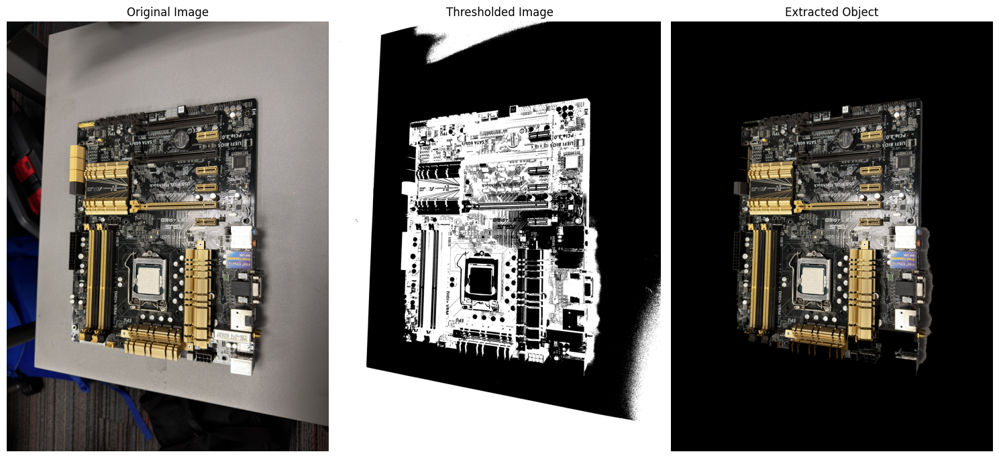

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image
image_path = '/content/motherboard_image.JPEG'  # Replace with your uploaded image path
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Apply Thresholding
# Using a fixed threshold for simplicity. Adjust the value (e.g., 100) as needed.
_, thresh = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY_INV)

# Step 4: Find Contours
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Step 5: Create a Mask
# Create an empty mask and draw the largest contour on it
mask = np.zeros_like(gray)
if contours:
    largest_contour = max(contours, key=cv2.contourArea)
    cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

# Step 6: Extract the Object
extracted = cv2.bitwise_and(img, img, mask=mask)

# Display Results
plt.figure(figsize=(15, 10))

plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title("Thresholded Image")
plt.imshow(thresh, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title("Extracted Object")
plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()


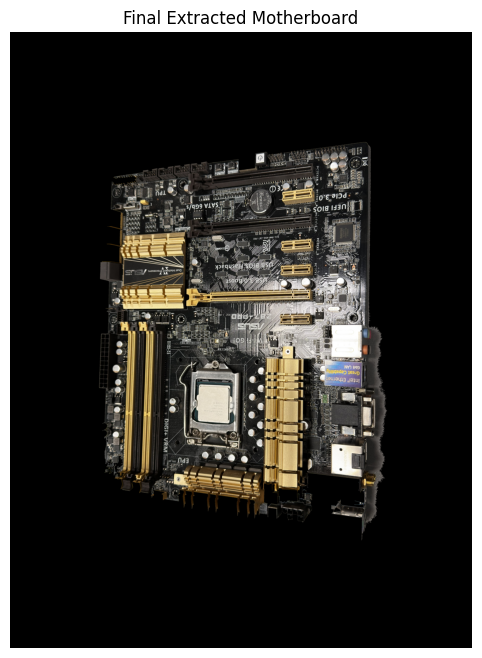

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image
image_path = '/content/motherboard_image (1).JPEG'  # Replace with your uploaded image path
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Apply Thresholding
_, thresh = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY_INV)

# Step 4: Find Contours
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Step 5: Create a Mask
mask = np.zeros_like(gray)
if contours:
    largest_contour = max(contours, key=cv2.contourArea)
    cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

# Step 6: Extract the Object
extracted = cv2.bitwise_and(img, img, mask=mask)

# Step 7: Show the Final Extracted Image
plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title("Final Extracted Motherboard")
plt.show()


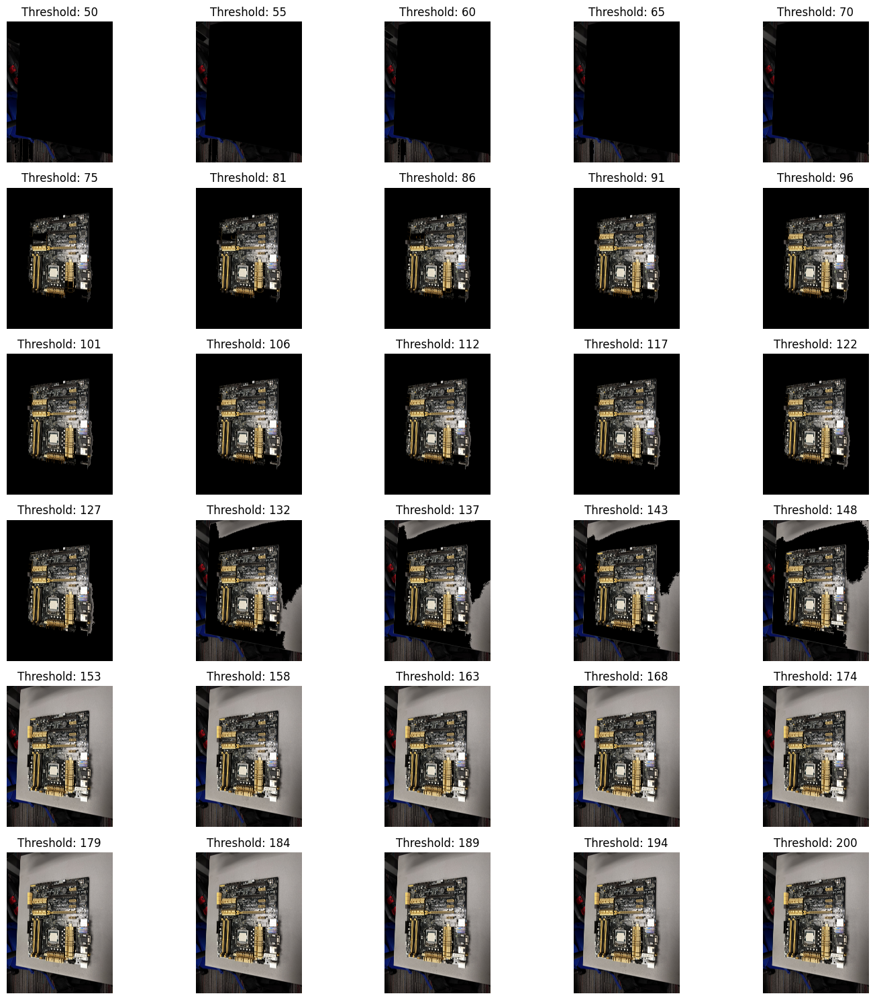

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image
image_path = '/content/motherboard_image (1).JPEG'  # Replace with your uploaded image path
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Define threshold values
threshold_values = np.linspace(50, 200, 30, dtype=int)  # 30 evenly spaced thresholds

# Initialize a figure for displaying results
plt.figure(figsize=(15, 15))
rows = 6  # Number of rows to display 30 results (5 images per row)

for i, thresh_val in enumerate(threshold_values):
    # Apply Thresholding
    _, thresh = cv2.threshold(gray, thresh_val, 255, cv2.THRESH_BINARY_INV)

    # Find Contours
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Create a Mask
    mask = np.zeros_like(gray)
    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

    # Extract the Object
    extracted = cv2.bitwise_and(img, img, mask=mask)

    # Display the Final Extracted Image
    plt.subplot(rows, 5, i + 1)  # 5 images per row
    plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title(f"Threshold: {thresh_val}")

# Show all results
plt.tight_layout()
plt.show()


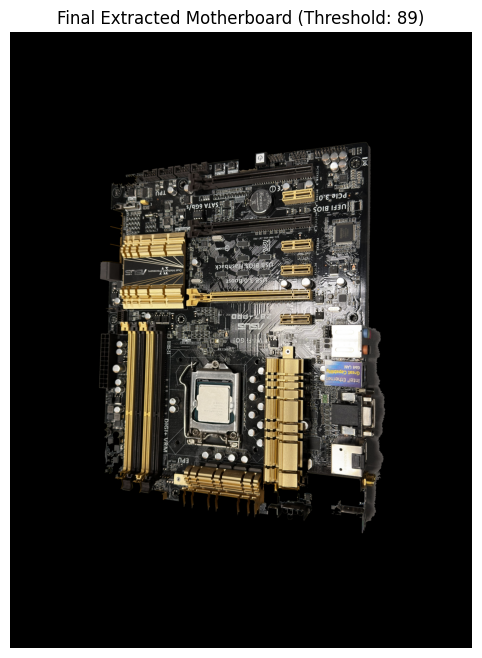

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image
image_path = '/content/motherboard_image (1).JPEG'  # Replace with your uploaded image path
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Apply the best threshold value
threshold_value = 89  # Best threshold determined
_, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

# Step 4: Find Contours
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Step 5: Create a Mask
mask = np.zeros_like(gray)
if contours:
    # Select the largest contour based on area
    largest_contour = max(contours, key=cv2.contourArea)
    cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

# Step 6: Refine the Mask with Morphological Operations
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))  # Elliptical kernel
mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)  # Close small gaps
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)  # Remove small noise

# Step 7: Extract the Object
extracted = cv2.bitwise_and(img, img, mask=mask)

# Step 8: Show the Final Extracted Image
plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title("Final Extracted Motherboard (Threshold: 89)")
plt.show()


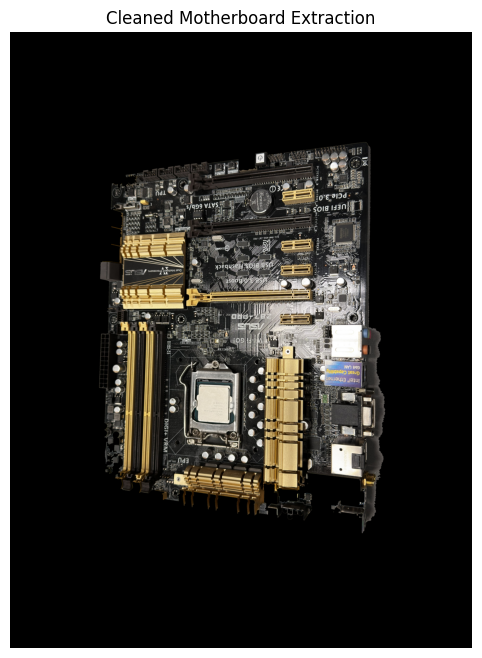

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image
image_path = '/content/motherboard_image (1).JPEG'  # Replace with your uploaded image path
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Apply the best threshold value
threshold_value = 89  # Best threshold determined
_, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

# Step 4: Find Contours
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Step 5: Create a Mask
mask = np.zeros_like(gray)
if contours:
    # Select the largest contour based on area
    largest_contour = max(contours, key=cv2.contourArea)
    cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

# Step 6: Refine the Mask with Morphological Operations
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))  # Larger kernel for stricter refinement
mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)  # Close small gaps
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)  # Remove small noise

# Step 7: Manually Mask the I/O Region
# This step removes regions outside the motherboard that were missed
height, width = mask.shape
cv2.rectangle(mask, (0, height - 100), (width, height), 0, thickness=-1)  # Adjust values if needed

# Step 8: Extract the Object
extracted = cv2.bitwise_and(img, img, mask=mask)

# Step 9: Show the Final Extracted Image
plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title("Cleaned Motherboard Extraction")
plt.show()


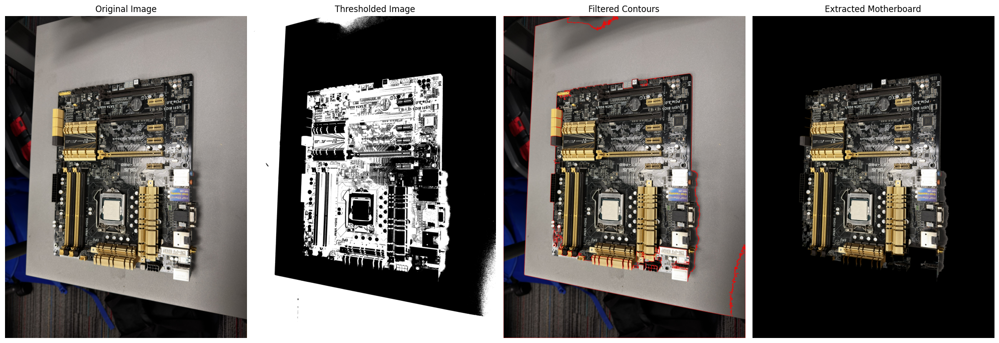

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image from the provided path
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Convert the image to RGB for visualization
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Apply thresholding
threshold_value = 88  # Adjust this value if needed
_, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

# Step 4: Detect contours
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Step 5: Filter contours by area
min_area = 5000  # Minimum contour area to keep (adjust as needed)
filtered_contours = [c for c in contours if cv2.contourArea(c) > min_area]

# Step 6: Draw filtered contours with adjustable line thickness
line_thickness = 3  # Set the desired line thickness
contour_img = img_rgb.copy()
cv2.drawContours(contour_img, filtered_contours, -1, (255, 0, 0), thickness=line_thickness)

# Step 7: Create a mask from the largest filtered contour
mask = np.zeros_like(gray)
if filtered_contours:
    largest_contour = max(filtered_contours, key=cv2.contourArea)
    cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

# Step 8: Extract the motherboard using the mask
extracted = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)

# Step 9: Visualize the results
plt.figure(figsize=(20, 10))

plt.subplot(1, 4, 1)
plt.title("Original Image")
plt.imshow(img_rgb)
plt.axis('off')

plt.subplot(1, 4, 2)
plt.title("Thresholded Image")
plt.imshow(thresh, cmap='gray')
plt.axis('off')

plt.subplot(1, 4, 3)
plt.title("Filtered Contours")
plt.imshow(contour_img)
plt.axis('off')

plt.subplot(1, 4, 4)
plt.title("Extracted Motherboard")
plt.imshow(extracted)
plt.axis('off')

plt.tight_layout()
plt.show()



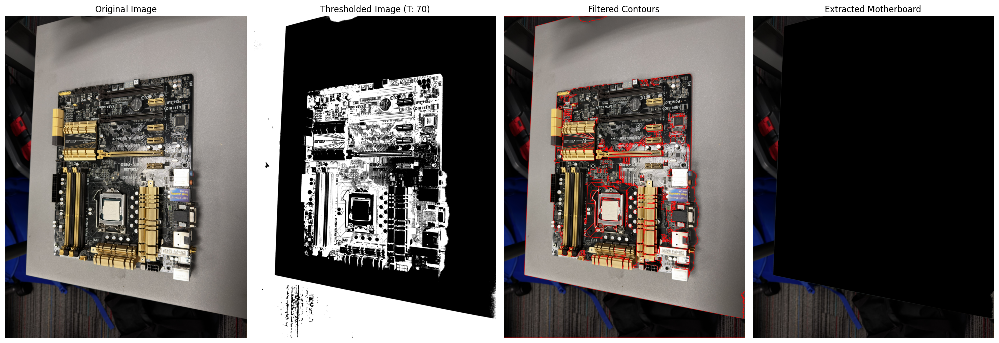

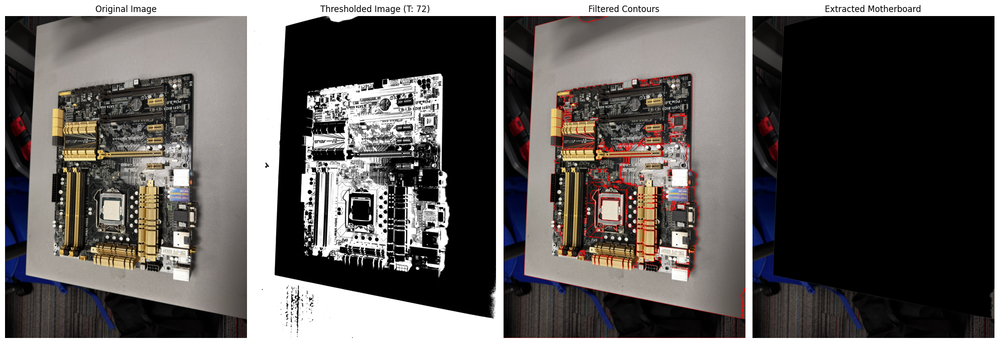

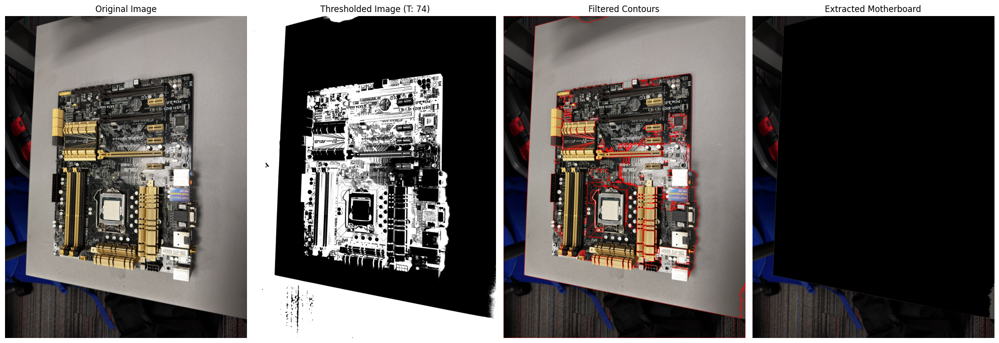

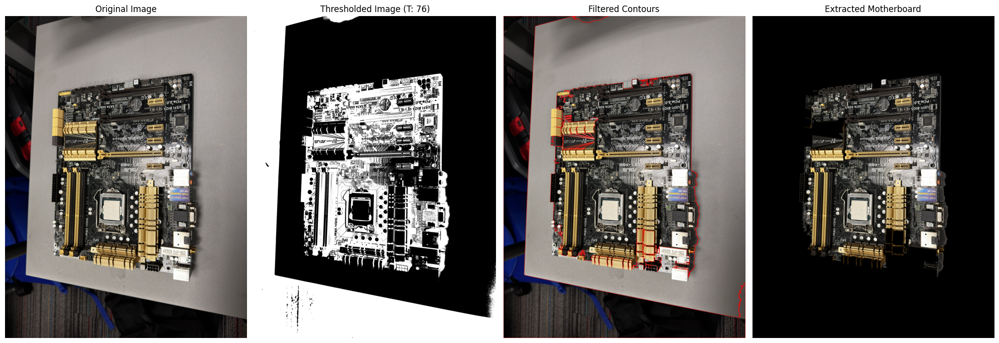

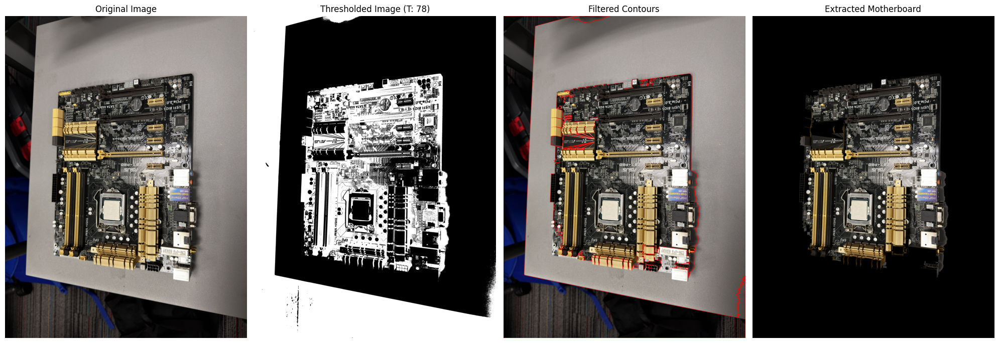

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image from the provided path
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Convert the image to RGB for visualization
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Define a range of threshold values
threshold_values = range(70, 80, 2)  # Adjust this range and step size as needed

# Loop through different threshold values
for threshold_value in threshold_values:
    # Apply thresholding
    _, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Detect contours
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter contours by area
    min_area = 5000  # Minimum contour area to keep
    filtered_contours = [c for c in contours if cv2.contourArea(c) > min_area]

    # Draw filtered contours with adjustable line thickness
    line_thickness = 3  # Set the desired line thickness
    contour_img = img_rgb.copy()
    cv2.drawContours(contour_img, filtered_contours, -1, (255, 0, 0), thickness=line_thickness)

    # Create a mask from the largest filtered contour
    mask = np.zeros_like(gray)
    if filtered_contours:
        largest_contour = max(filtered_contours, key=cv2.contourArea)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

    # Extract the motherboard using the mask
    extracted = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)

    # Visualize the results for the current threshold
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 4, 1)
    plt.title("Original Image")
    plt.imshow(img_rgb)
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.title(f"Thresholded Image (T: {threshold_value})")
    plt.imshow(thresh, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.title("Filtered Contours")
    plt.imshow(contour_img)
    plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.title("Extracted Motherboard")
    plt.imshow(extracted)
    plt.axis('off')

    plt.tight_layout()
    plt.show()




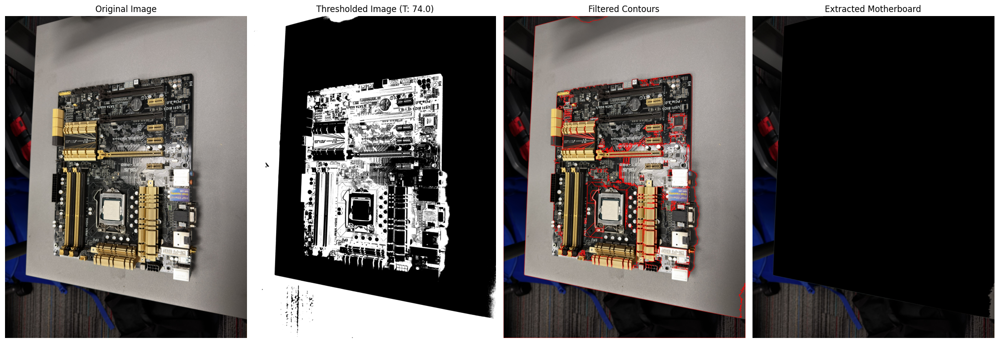

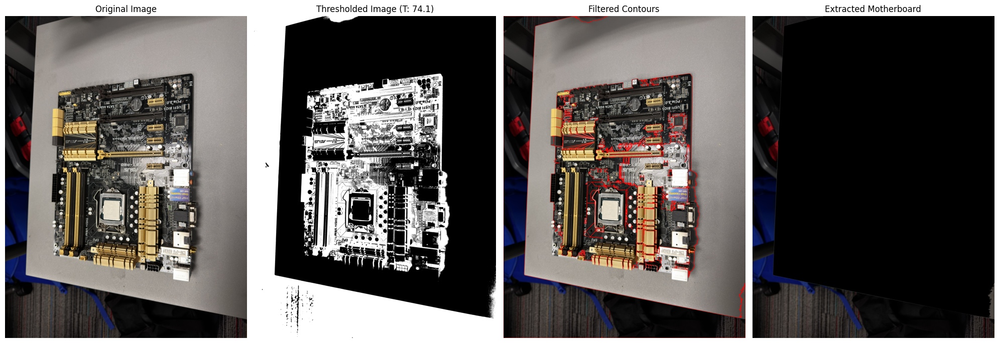

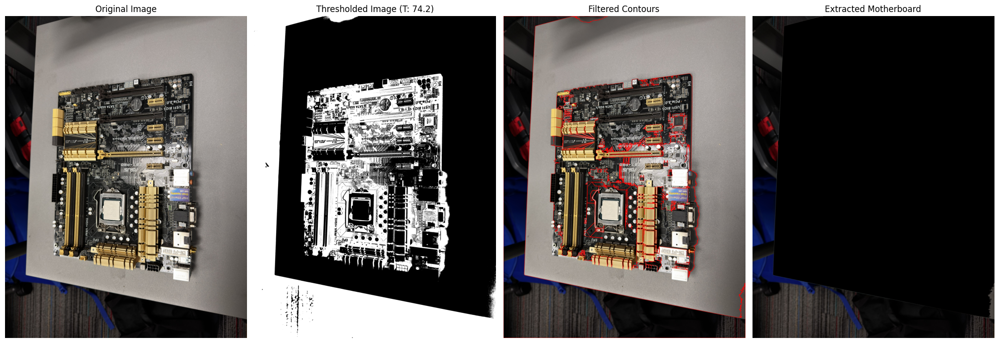

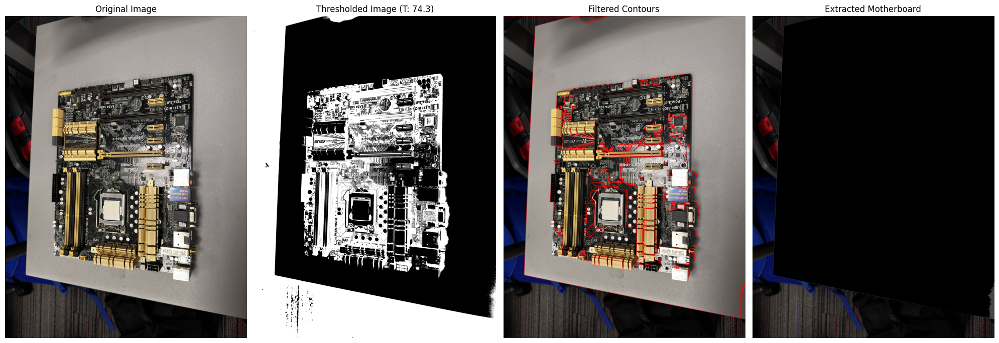

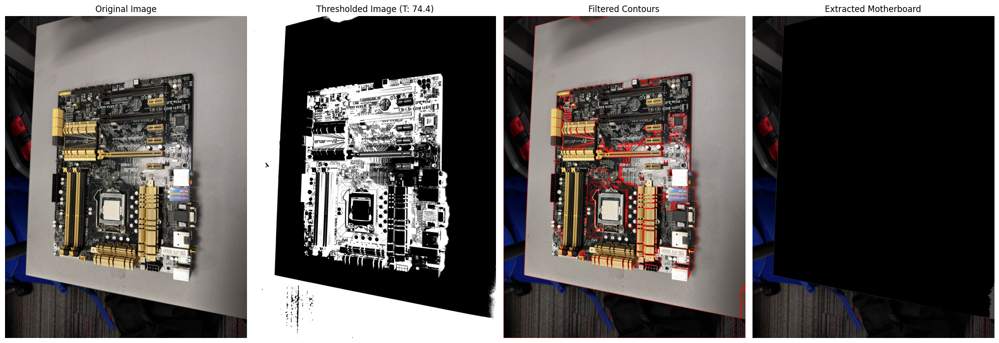

...

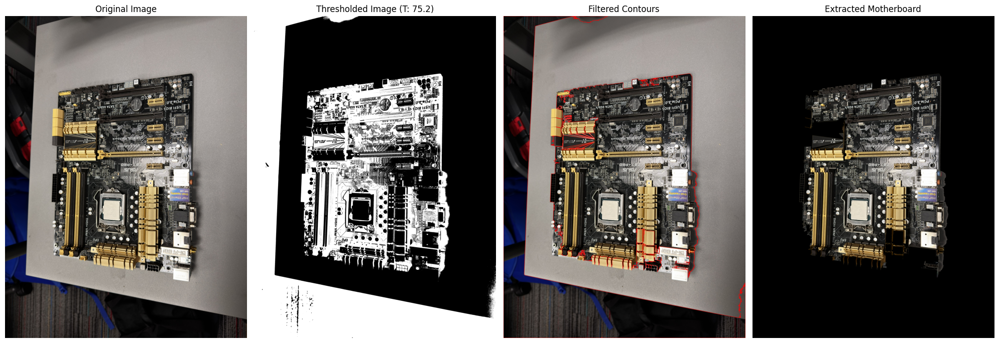

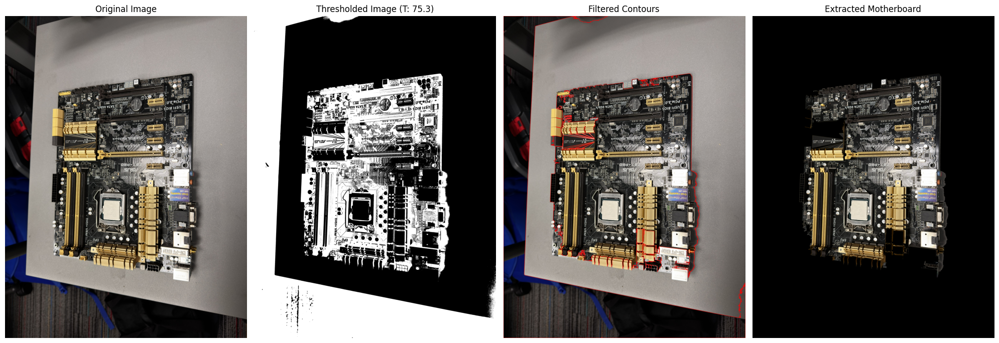

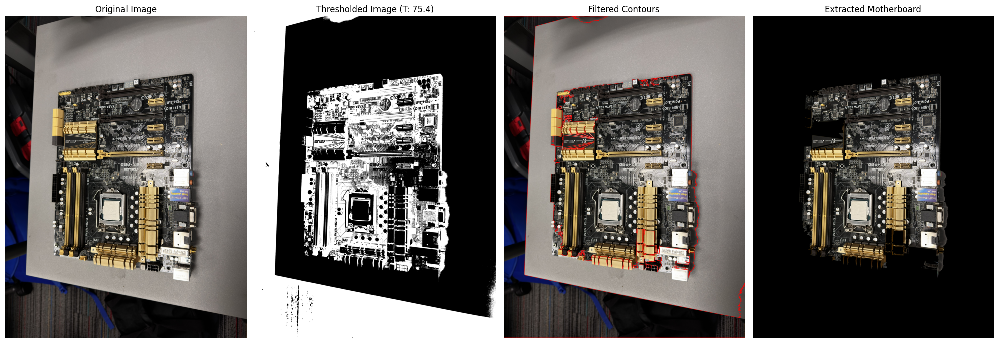

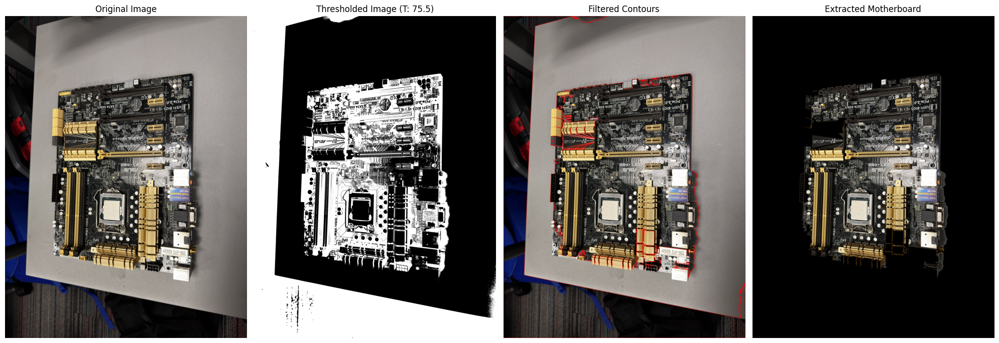

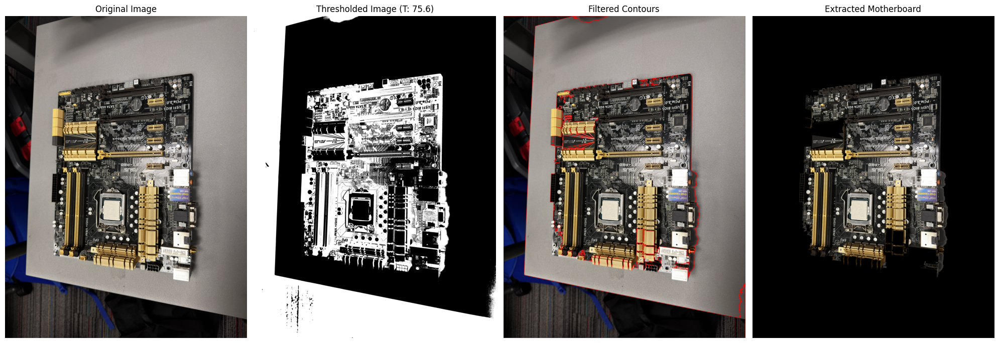

KeyboardInterrupt: 

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image from the provided path
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Convert the image to RGB for visualization
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Define a range of threshold values between 74 and 76
threshold_values = np.arange(74.0, 76.1, 0.1)  # Thresholds from 74.0 to 76.0 with step 0.1

# Loop through different threshold values
for threshold_value in threshold_values:
    # Apply thresholding
    _, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Detect contours
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter contours by area
    min_area = 5000  # Minimum contour area to keep
    filtered_contours = [c for c in contours if cv2.contourArea(c) > min_area]

    # Draw filtered contours with adjustable line thickness
    line_thickness = 3  # Set the desired line thickness
    contour_img = img_rgb.copy()
    cv2.drawContours(contour_img, filtered_contours, -1, (255, 0, 0), thickness=line_thickness)

    # Create a mask from the largest filtered contour
    mask = np.zeros_like(gray)
    if filtered_contours:
        largest_contour = max(filtered_contours, key=cv2.contourArea)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

    # Extract the motherboard using the mask
    extracted = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)

    # Visualize the results for the current threshold
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 4, 1)
    plt.title("Original Image")
    plt.imshow(img_rgb)
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.title(f"Thresholded Image (T: {threshold_value:.1f})")
    plt.imshow(thresh, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.title("Filtered Contours")
    plt.imshow(contour_img)
    plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.title("Extracted Motherboard")
    plt.imshow(extracted)
    plt.axis('off')

    plt.tight_layout()
    plt.show()


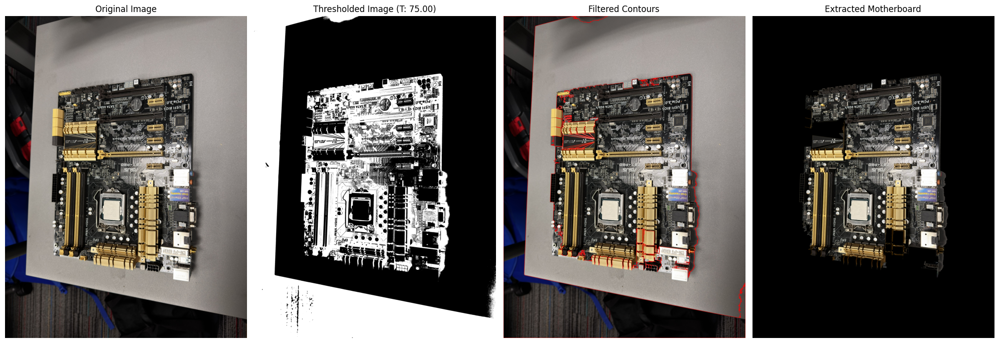

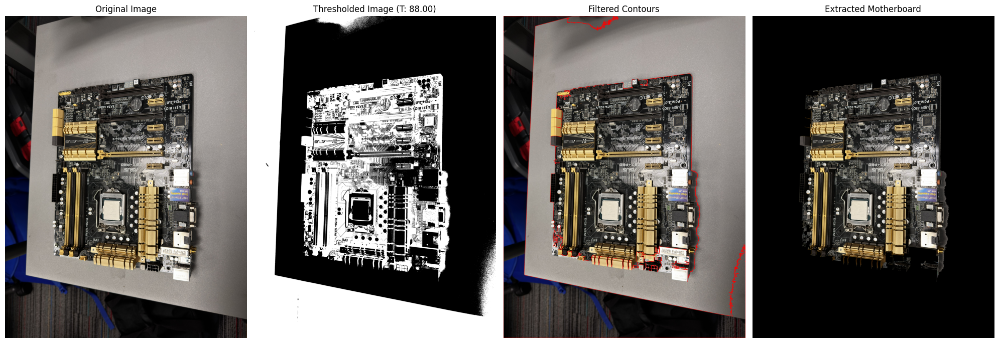

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image from the provided path
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Convert the image to RGB for visualization
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Define a range of threshold values between 75.0 and 75.1
threshold_values = np.arange(75, 89, 13)  # Thresholds from 75.0 to 75.1 with step 0.01

# Loop through different threshold values
for threshold_value in threshold_values:
    # Apply thresholding
    _, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Detect contours
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter contours by area
    min_area = 5000  # Minimum contour area to keep
    filtered_contours = [c for c in contours if cv2.contourArea(c) > min_area]

    # Draw filtered contours with adjustable line thickness
    line_thickness = 3  # Set the desired line thickness
    contour_img = img_rgb.copy()
    cv2.drawContours(contour_img, filtered_contours, -1, (255, 0, 0), thickness=line_thickness)

    # Create a mask from the largest filtered contour
    mask = np.zeros_like(gray)
    if filtered_contours:
        largest_contour = max(filtered_contours, key=cv2.contourArea)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

    # Extract the motherboard using the mask
    extracted = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)

    # Visualize the results for the current threshold
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 4, 1)
    plt.title("Original Image")
    plt.imshow(img_rgb)
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.title(f"Thresholded Image (T: {threshold_value:.2f})")
    plt.imshow(thresh, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.title("Filtered Contours")
    plt.imshow(contour_img)
    plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.title("Extracted Motherboard")
    plt.imshow(extracted)
    plt.axis('off')

    plt.tight_layout()
    plt.show()



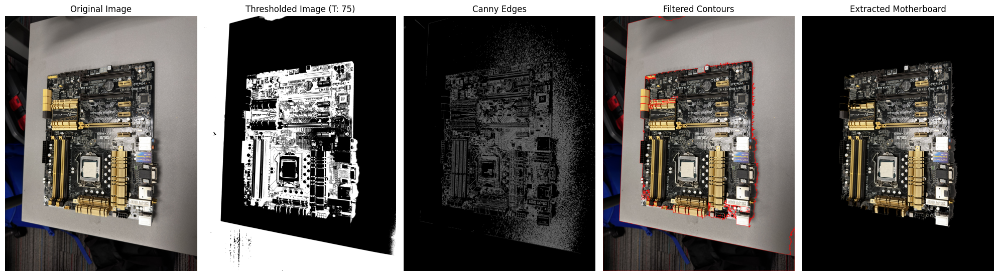

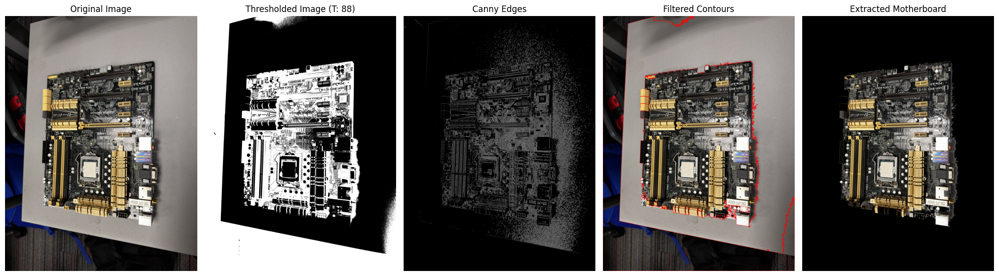

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image from the provided path
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Convert the image to RGB for visualization
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Define the specific threshold values
threshold_values = [75, 88]  # Thresholds to process

# Loop through the specified threshold values
for threshold_value in threshold_values:
    # Apply thresholding
    _, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Apply Canny edge detection
    edges = cv2.Canny(gray, 50, 150)  # Adjust thresholds for edge detection as needed

    # Combine threshold and edges
    combined_mask = cv2.bitwise_or(thresh, edges)

    # Detect contours from the combined mask
    contours, hierarchy = cv2.findContours(combined_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter contours by area
    min_area = 5000  # Minimum contour area to keep
    filtered_contours = [c for c in contours if cv2.contourArea(c) > min_area]

    # Draw filtered contours with adjustable line thickness
    line_thickness = 3  # Set the desired line thickness
    contour_img = img_rgb.copy()
    cv2.drawContours(contour_img, filtered_contours, -1, (255, 0, 0), thickness=line_thickness)

    # Create a mask from the largest filtered contour
    mask = np.zeros_like(gray)
    if filtered_contours:
        largest_contour = max(filtered_contours, key=cv2.contourArea)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

    # Extract the motherboard using the mask
    extracted = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)

    # Visualize the results for the current threshold
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 5, 1)
    plt.title("Original Image")
    plt.imshow(img_rgb)
    plt.axis('off')

    plt.subplot(1, 5, 2)
    plt.title(f"Thresholded Image (T: {threshold_value})")
    plt.imshow(thresh, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 5, 3)
    plt.title("Canny Edges")
    plt.imshow(edges, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 5, 4)
    plt.title("Filtered Contours")
    plt.imshow(contour_img)
    plt.axis('off')

    plt.subplot(1, 5, 5)
    plt.title("Extracted Motherboard")
    plt.imshow(extracted)
    plt.axis('off')

    plt.tight_layout()
    plt.show()


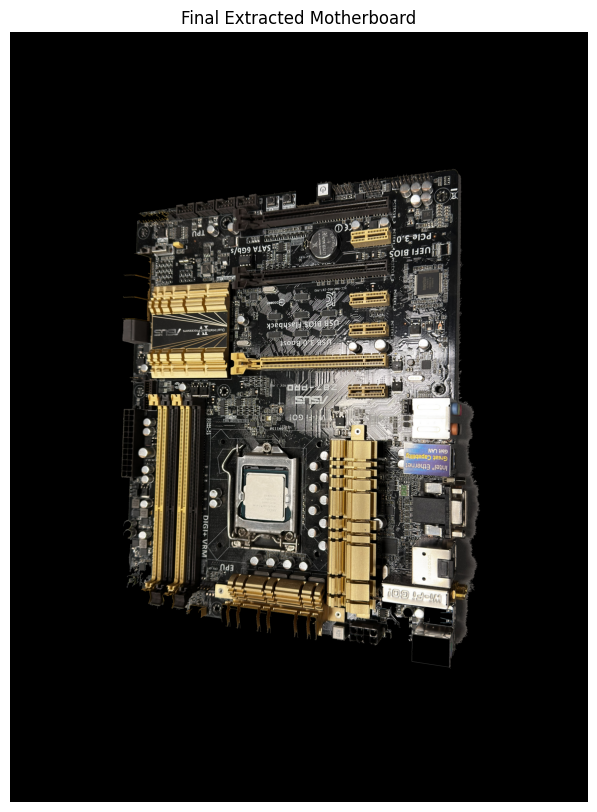

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image from the provided path
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Convert the image to RGB for visualization
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Define the specific threshold values
threshold_values = [88]  # Thresholds to process

# Loop through the specified threshold values
for threshold_value in threshold_values:
    # Apply thresholding
    _, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Apply Canny edge detection
    edges = cv2.Canny(gray, 200, 100)  # Adjust thresholds for edge detection as needed

    # Combine threshold and edges
    combined_mask = cv2.bitwise_or(thresh, edges)

    # Detect contours from the combined mask
    contours, hierarchy = cv2.findContours(combined_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter contours by area
    min_area = 500  # Minimum contour area to keep
    filtered_contours = [c for c in contours if cv2.contourArea(c) > min_area]

    # Create a mask from the largest filtered contour
    mask = np.zeros_like(gray)
    if filtered_contours:
        largest_contour = max(filtered_contours, key=cv2.contourArea)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

    # Extract the motherboard using the mask
    extracted = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)

    # Display only the final extracted motherboard image
    plt.figure(figsize=(10, 10))
    plt.title("Final Extracted Motherboard")
    plt.imshow(extracted)
    plt.axis('off')
    plt.show()


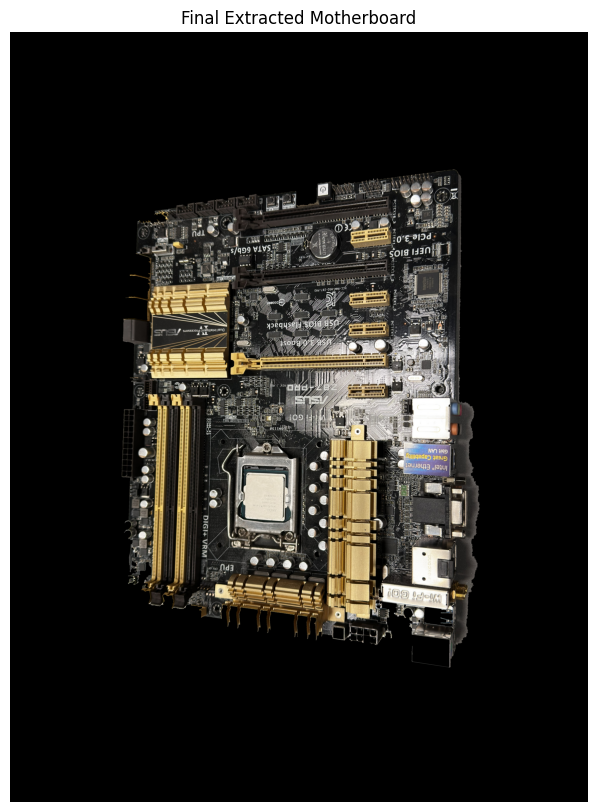

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image from the provided path
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

# Convert the image to RGB for visualization
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Define the specific threshold values
threshold_values = [88]  # Thresholds to process

# Loop through the specified threshold values
for threshold_value in threshold_values:
    # Apply thresholding
    _, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Apply Canny edge detection
    edges = cv2.Canny(gray, 200, 200)  # Adjust thresholds for edge detection as needed

    # Combine threshold and edges
    combined_mask = cv2.bitwise_or(thresh, edges)

    # Detect contours from the combined mask
    contours, hierarchy = cv2.findContours(combined_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter contours by area
    min_area = 4000  # Minimum contour area to keep
    filtered_contours = [c for c in contours if cv2.contourArea(c) > min_area]

    # Create a mask from the largest filtered contour
    mask = np.zeros_like(gray)
    if filtered_contours:
        largest_contour = max(filtered_contours, key=cv2.contourArea)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

    # Step 4: Apply morphological operations to refine the mask
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (10, 10))  # Kernel for morphological ops
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)  # Close gaps in the mask

    # Extract the motherboard using the refined mask
    extracted = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)

    # Display only the final extracted motherboard image
    plt.figure(figsize=(10, 10))
    plt.title("Final Extracted Motherboard")
    plt.imshow(extracted)
    plt.axis('off')
    plt.show()
